<a href="https://colab.research.google.com/github/Divyanshu-sharma-coder/Transformation-of-Mathematical-Columns-/blob/main/Log.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importing Necessary Libraries And Dataset

In [ ]:
from google.colab import files
files.upload()

Saving airlines_flights_data.csv to airlines_flights_data (1).csv


{'airlines_flights_data (1).csv': b'index,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price\r\n0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953\r\n1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953\r\n2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956\r\n3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955\r\n4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955\r\n5,Vistara,UK-945,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.33,1,5955\r\n6,Vistara,UK-927,Delhi,Morning,zero,Morning,Mumbai,Economy,2.08,1,6060\r\n7,Vistara,UK-951,Delhi,Afternoon,zero,Evening,Mumbai,Economy,2.17,1,6060\r\n8,GO_FIRST,G8-334,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.17,1,5954\r\n9,GO_FIRST,G8-336,Delhi,Afternoon,zero,Evening,Mumbai,Economy,2.25,1,5954\r\n10,GO_FIRST,G8-392,Delhi,Afternoon,zero,Evening,Mumbai,Economy,2.25,1,

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder
from scipy import stats
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import FunctionTransformer
from sklearn.pipeline import make_pipeline

# Data Information

In [ ]:
df = pd.read_csv("airlines_flights_data.csv")

In [ ]:
df.drop(["flight"], axis=1, inplace=True)

In [ ]:
df.head()

,index,airline,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,0,SpiceJet,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,1,SpiceJet,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953
2,2,AirAsia,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956
3,3,Vistara,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955
4,4,Vistara,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955


# Train-Test-Split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(df.iloc[:,0:10], df.iloc[:, -1], test_size=0.3)

In [ ]:
X_train.head()

,index,airline,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left
87546,87546,Air_India,Bangalore,Evening,one,Morning,Delhi,Economy,15.58,19
210378,210378,Vistara,Delhi,Evening,one,Night,Mumbai,Business,5.75,35
194910,194910,Vistara,Chennai,Morning,one,Afternoon,Bangalore,Economy,30.25,16
166922,166922,Vistara,Hyderabad,Morning,one,Morning,Bangalore,Economy,24.33,16
9095,9095,Vistara,Delhi,Evening,one,Night,Mumbai,Economy,5.33,45


In [ ]:
y_train.head()

,price
87546,4294
210378,53164
194910,22175
166922,5441
9095,5857


# Encoding through Column Transformer

In [ ]:
preprocessor = ColumnTransformer(
    transformers=[
        ('ohe', OneHotEncoder(sparse_output=False), [1, 2, 3, 4, 5, 6]),
        ('oe', OrdinalEncoder(categories=[["Economy", "Business"]]), [7])
    ],
    remainder="passthrough"
)

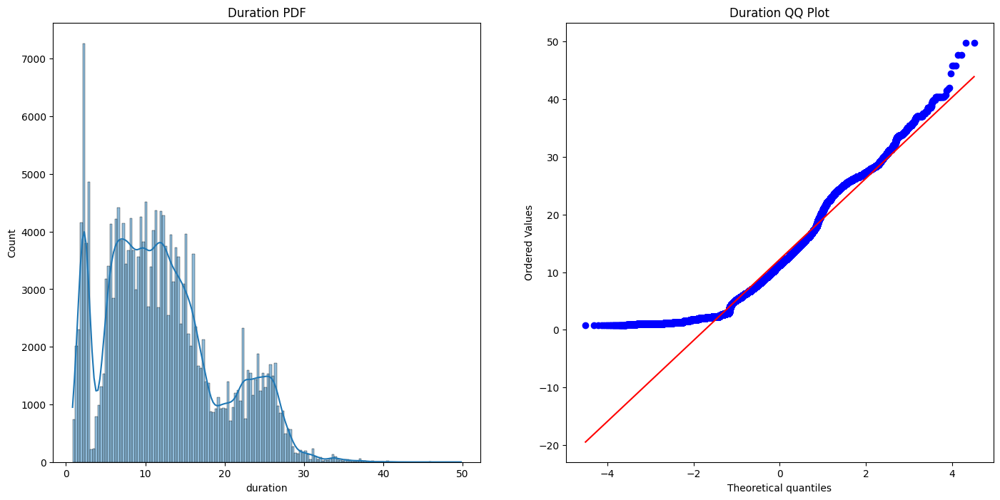

In [ ]:
plt.figure(figsize=(17, 8))
plt.subplot(121)
sns.histplot(X_train["duration"],kde=True)
plt.title("Duration PDF")
plt.subplot(122)
stats.probplot(X_train["duration"], dist="norm", plot=plt)
plt.title("Duration QQ Plot")
plt.show()

* Highly Right skewed

# Transformation
  1. LOG TRANSFORM
  2. RECIPROCAL TRANSFORM
  3. SQUARE TRANSFORM
  4. SQUARE ROOT TRANSFORM

# LOG TRANSFORM

In [ ]:
trf = FunctionTransformer(func=np.log1p)

In [ ]:
X_train_log = trf.fit_transform(X_train[["duration"]])

In [ ]:
X_test_log = trf.transform(X_test[["duration"]])

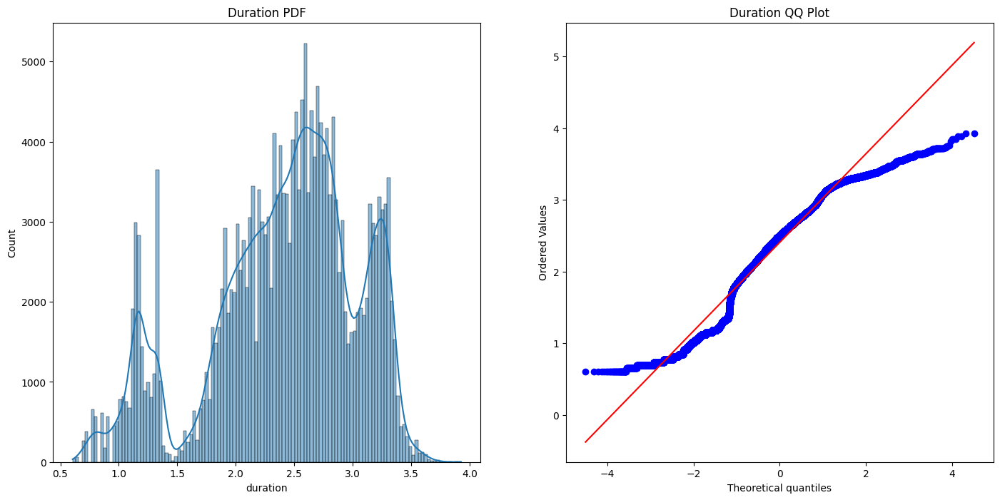

In [ ]:
plt.figure(figsize=(17, 8))
plt.subplot(121)
sns.histplot(X_train_log,kde=True)
plt.title("Duration PDF")
plt.subplot(122)
stats.probplot(X_train_log, dist="norm", plot=plt)
plt.title("Duration QQ Plot")
plt.show()

* Here we can see the graph come closer to normal distribution

#Resiprocal

In [ ]:
trf2 = FunctionTransformer(func=lambda x : 1/(x + 1e-6))

In [ ]:
X_train_resiprocal = trf2.fit_transform(X_train["duration"])

In [ ]:
X_test_lresiprocal = trf2.transform(X_test["duration"])

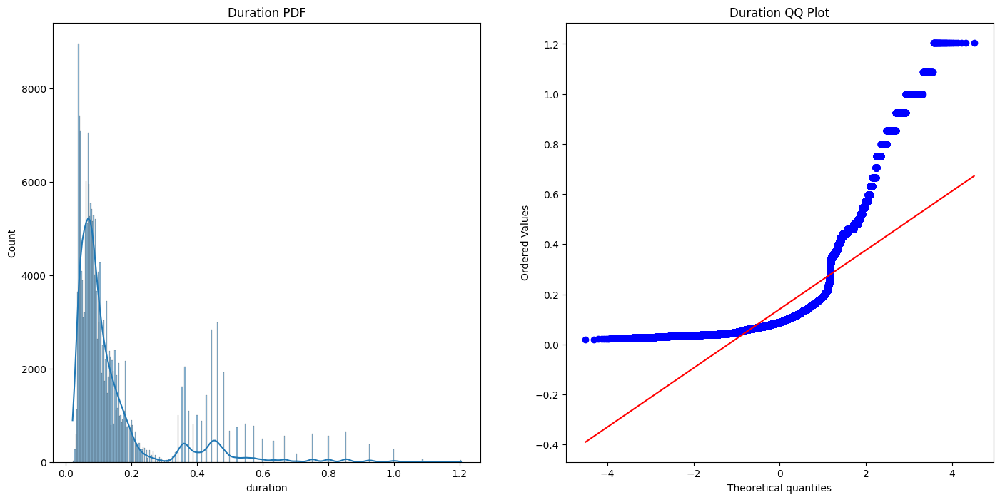

In [ ]:
plt.figure(figsize=(17, 8))
plt.subplot(121)
sns.histplot(X_train_resiprocal ,kde=True)
plt.title("Duration PDF")
plt.subplot(122)
stats.probplot(X_train_resiprocal, dist="norm", plot=plt)
plt.title("Duration QQ Plot")
plt.show()

# X² Transformer

In [ ]:
trf3 = FunctionTransformer(func = lambda x : x**2)

In [ ]:
X_train_square = trf3.fit_transform(X_train["duration"])

In [ ]:
X_test_square = trf3.transform(X_train["duration"])

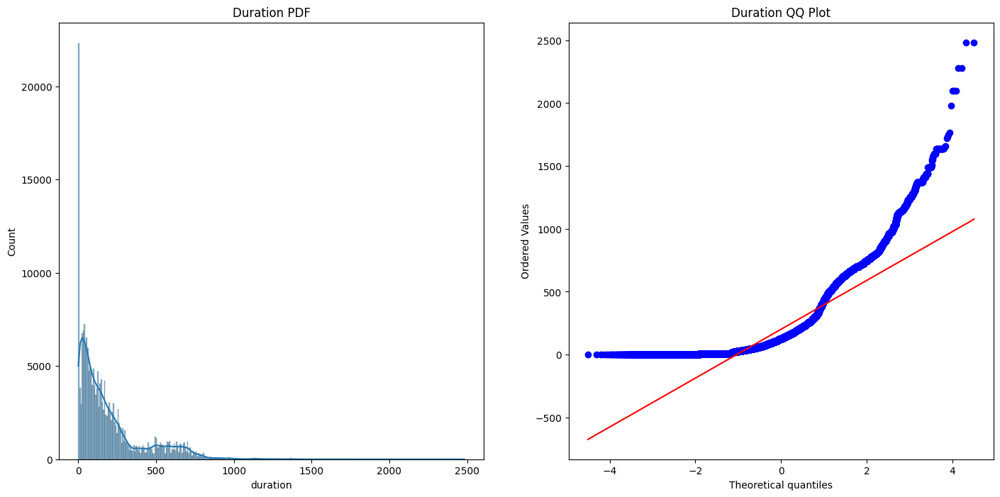

In [ ]:
plt.figure(figsize=(17, 8))
plt.subplot(121)
sns.histplot(X_train_square,kde=True)
plt.title("Duration PDF")
plt.subplot(122)
stats.probplot(X_train_square, dist="norm", plot=plt)
plt.title("Duration QQ Plot")
plt.show()

# X½ Transformer

In [ ]:
trf4 = FunctionTransformer (func= np.sqrt)

In [ ]:
X_train_root = trf4.fit_transform(X_train["duration"])

In [ ]:
X_test_root = trf4.transform(X_test["duration"])

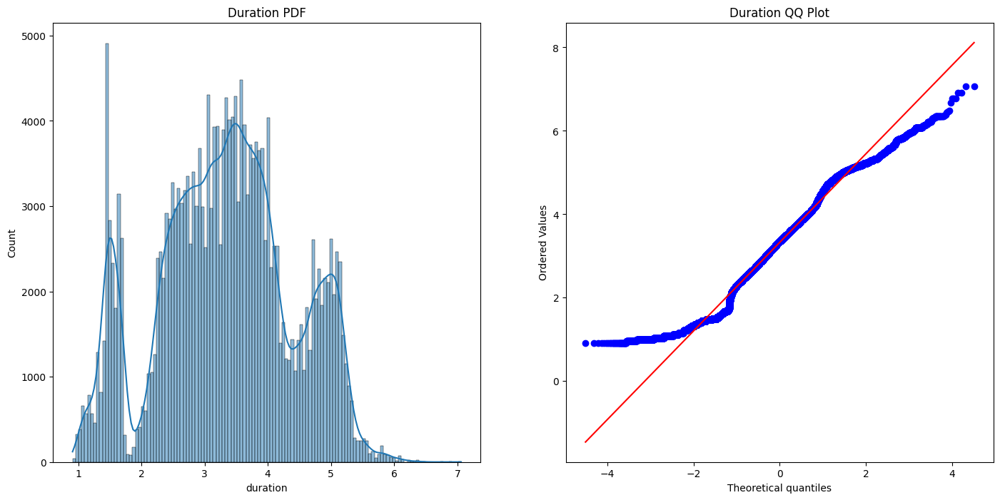

In [ ]:
plt.figure(figsize=(17, 8))
plt.subplot(121)
sns.histplot(X_train_root,kde=True)
plt.title("Duration PDF")
plt.subplot(122)
stats.probplot(X_train_root, dist="norm", plot=plt)
plt.title("Duration QQ Plot")
plt.show()

# After applying all of these the conclusion is that the winner is square root
 * Order : square root > Log > Reciprocal > square
 * Best or closest to normal distribution is formed by square root

In [ ]:
preprocessor_2 = ColumnTransformer([
('Square_root' , FunctionTransformer(func=np.sqrt), [8])
], remainder = "passthrough")

# Transformation on price column

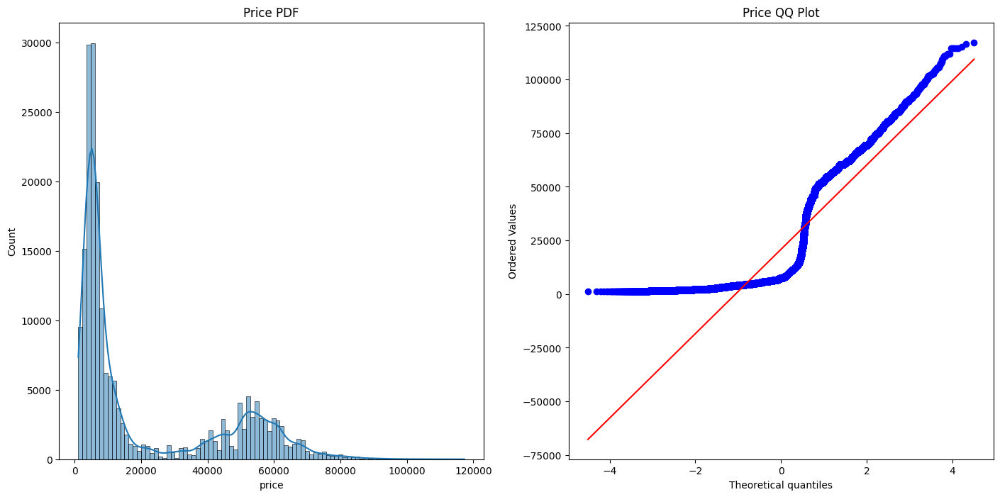

In [ ]:
plt.figure(figsize=(17, 8))
plt.subplot(121)
sns.histplot(y_train,kde=True)
plt.title("Price PDF")
plt.subplot(122)
stats.probplot(y_train, dist="norm", plot=plt)
plt.title("Price QQ Plot")
plt.show()

* Also a Right skewed Column Again same transformation 😁

In [ ]:
def square_root(x):
 return np.sqrt(x)

In [ ]:
trf5 = FunctionTransformer(func=square_root)

In [ ]:
y_train_root = trf5.fit_transform(y_train)
y_test_root = trf5.transform(y_test)

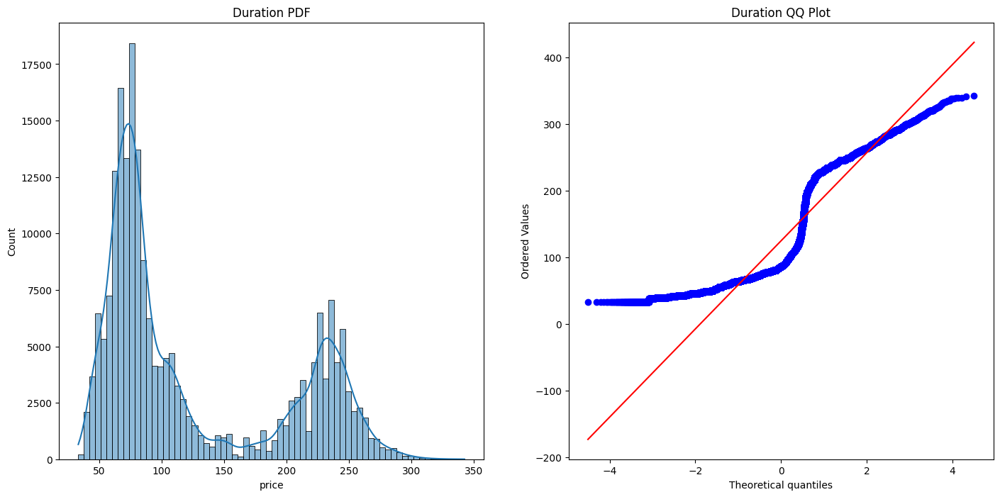

In [ ]:
plt.figure(figsize=(17, 8))
plt.subplot(121)
sns.histplot(y_train_root,kde=True)
plt.title("Duration PDF")
plt.subplot(122)
stats.probplot(y_train_root, dist="norm", plot=plt)
plt.title("Duration QQ Plot")
plt.show()

In [ ]:
trf6 = FunctionTransformer(func=np.log1p)

In [ ]:
y_train_log = trf6.fit_transform(y_train)
y_test_log = trf6.transform(y_test)

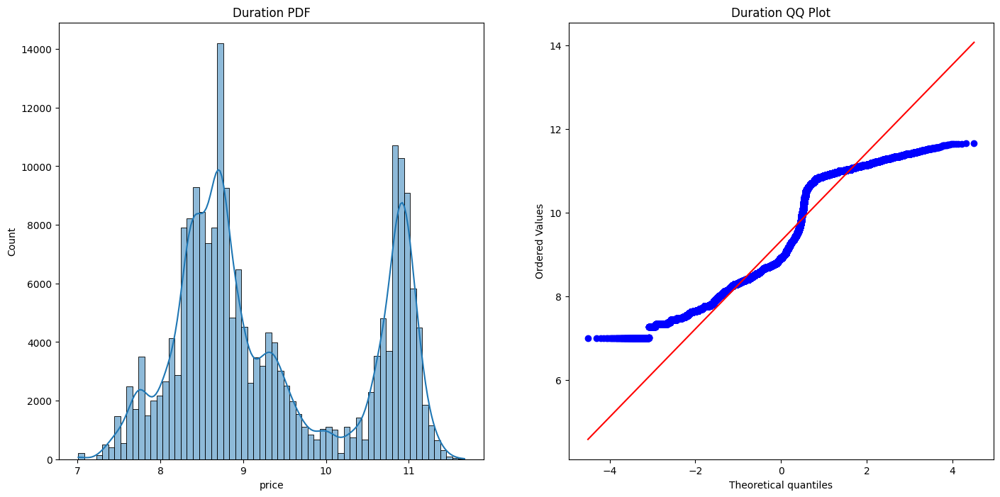

In [ ]:
plt.figure(figsize=(17, 8))
plt.subplot(121)
sns.histplot(y_train_log,kde=True)
plt.title("Duration PDF")
plt.subplot(122)
stats.probplot(y_train_log, dist="norm", plot=plt)
plt.title("Duration QQ Plot")
plt.show()

In [ ]:
trf7 = FunctionTransformer (func=lambda x : 1/(x+ 1e-6))

In [ ]:
y_train_resiprocal = trf7.fit_transform(y_train)
y_test_resiprocal = trf7.transform(y_test)

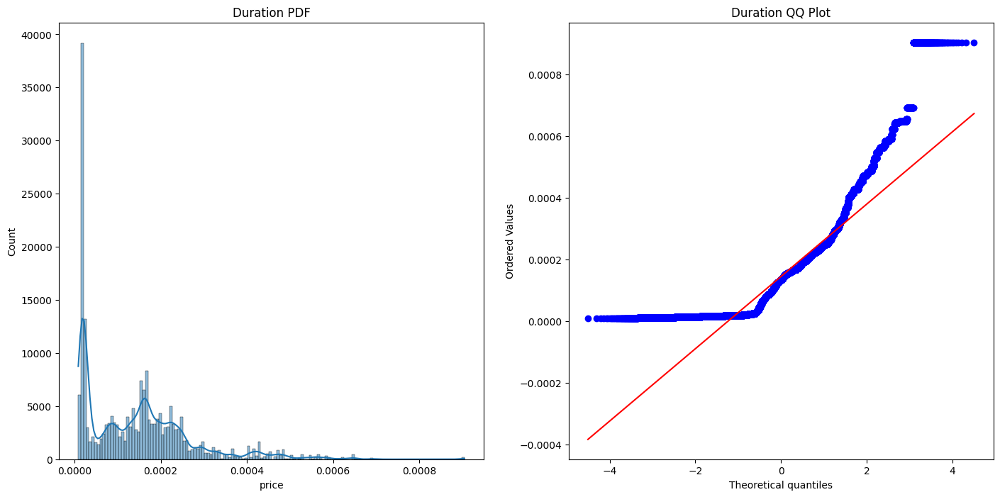

In [ ]:
plt.figure(figsize=(17, 8))
plt.subplot(121)
sns.histplot(y_train_resiprocal,kde=True)
plt.title("Duration PDF")
plt.subplot(122)
stats.probplot(y_train_resiprocal, dist="norm", plot=plt)
plt.title("Duration QQ Plot")
plt.show()

# So On The Bases Of All Transformation
  * The conclusion is Log is the best for price column because after doing log transformation the graph become closer to Normal Distribution

In [ ]:
preprocessor_3 = ColumnTransformer([
("root", FunctionTransformer(func=np.log1p), [10])
], remainder= "passthrough")

In [ ]:
pipeline = make_pipeline(preprocessor, preprocessor_2, preprocessor_3)

In [ ]:
pipeline

Pipeline(steps=[('columntransformer-1',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ohe',
                                                  OneHotEncoder(sparse_output=False),
                                                  [1, 2, 3, 4, 5, 6]),
                                                 ('oe',
                                                  OrdinalEncoder(categories=[['Economy',
                                                                              'Business']]),
                                                  [7])])),
                ('columntransformer-2',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('Square_root',
                                                  FunctionTransformer(func=<ufunc 'sqrt'>),
                                                  [8])])),
                ('columntransformer-3',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('root',
                                                  FunctionTransformer(func=<ufunc 'log1p'>),
                                                  [10])]))])

In [ ]:
pipeline.fit(X_train, y_train)

Pipeline(steps=[('columntransformer-1',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ohe',
                                                  OneHotEncoder(sparse_output=False),
                                                  [1, 2, 3, 4, 5, 6]),
                                                 ('oe',
                                                  OrdinalEncoder(categories=[['Economy',
                                                                              'Business']]),
                                                  [7])])),
                ('columntransformer-2',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('Square_root',
                                                  FunctionTransformer(func=<ufunc 'sqrt'>),
                                                  [8])])),
                ('columntransformer-3',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('root',
                                                  FunctionTransformer(func=<ufunc 'log1p'>),
                                                  [10])]))])

In [ ]:
col_names = preprocessor.get_feature_names_out()

In [ ]:
X_transformed = pipeline.transform(X_train)

In [ ]:
X_train_new = pd.DataFrame(X_transformed,
columns =col_names)
X_train_new.head()

,ohe__airline_AirAsia,ohe__airline_Air_India,ohe__airline_GO_FIRST,ohe__airline_Indigo,ohe__airline_SpiceJet,ohe__airline_Vistara,ohe__source_city_Bangalore,ohe__source_city_Chennai,ohe__source_city_Delhi,ohe__source_city_Hyderabad,...,ohe__destination_city_Bangalore,ohe__destination_city_Chennai,ohe__destination_city_Delhi,ohe__destination_city_Hyderabad,ohe__destination_city_Kolkata,ohe__destination_city_Mumbai,oe__class,remainder__index,remainder__duration,remainder__days_left
0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,87546.0,15.58,19.0
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,210378.0,5.75,35.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,194910.0,30.25,16.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,166922.0,24.33,16.0
4,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,9095.0,5.33,45.0


In [ ]:
X_train_new.columns = [
    col.replace("ohe__airline_", "")
       .replace("oe__", "")
       .replace("ohe__source_city_", "Source City: ")
       .replace("ohe__destination_city_","Destination:")
       .replace("ohe__arrival_time_", "Arrival:")
       .replace("ohe__departure_time_", "Departure Time:")
       .replace("ohe__stops_" , "Stops :")
       .replace("remainder__", "")
    for col in X_train_new.columns
]

In [ ]:
X_train_new.iloc[:, 25:32]

,Arrival:Morning,Arrival:Night,Destination:Bangalore,Destination:Chennai,Destination:Delhi,Destination:Hyderabad,Destination:Kolkata
0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,1.0,0.0,1.0,0.0,0.0,0.0,0.0
4,0.0,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...
210102,0.0,0.0,1.0,0.0,0.0,0.0,0.0
210103,0.0,0.0,0.0,0.0,1.0,0.0,0.0
210104,1.0,0.0,0.0,0.0,0.0,0.0,1.0
210105,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
X_train_new.head()

,AirAsia,Air_India,GO_FIRST,Indigo,SpiceJet,Vistara,Source City: Bangalore,Source City: Chennai,Source City: Delhi,Source City: Hyderabad,...,Destination:Bangalore,Destination:Chennai,Destination:Delhi,Destination:Hyderabad,Destination:Kolkata,Destination:Mumbai,class,index,duration,days_left
0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,87546.0,15.58,19.0
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,210378.0,5.75,35.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,194910.0,30.25,16.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,166922.0,24.33,16.0
4,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,9095.0,5.33,45.0


In [ ]:
X_test_transform = pipeline.transform(X_test)

In [ ]:
X_test_new = pd.DataFrame(X_test_transform,
columns=col_names)

In [ ]:
X_test_new.columns = [
    col.replace("ohe__airline_", "")
       .replace("oe__", "")
       .replace("ohe__source_city_", "Source City: ")
       .replace("ohe__destination_city_","Destination:")
       .replace("ohe__arrival_time_", "Arrival:")
       .replace("ohe__departure_time_", "Departure Time:")
       .replace("ohe__stops_" , "Stops :")
       .replace("remainder__", "")
    for col in X_test_new.columns
]

In [ ]:
X_test_new.head()

,AirAsia,Air_India,GO_FIRST,Indigo,SpiceJet,Vistara,Source City: Bangalore,Source City: Chennai,Source City: Delhi,Source City: Hyderabad,...,Destination:Bangalore,Destination:Chennai,Destination:Delhi,Destination:Hyderabad,Destination:Kolkata,Destination:Mumbai,class,index,duration,days_left
0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,101153.0,6.08,41.0
1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,190138.0,5.67,22.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,292067.0,13.17,28.0
3,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,28076.0,11.58,46.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,117133.0,27.33,21.0


In [ ]:
X_full = np.concatenate([X_train_new, X_test_new], axis=0)

In [ ]:
y_full = np.concatenate([y_train, y_test],axis=0)

In [ ]:
Final = np.concatenate([X_full, y_full.reshape(-1, 1)], axis=1)

In [ ]:
final_df = pd.DataFrame(X_full, columns=col_names)
final_df["Price"] = y_full

In [ ]:
final_df.columns = [
    col.replace("ohe__airline_", "")
       .replace("oe__", "")
       .replace("ohe__source_city_", "Source City: ")
       .replace("ohe__destination_city_","Destination:")
       .replace("ohe__arrival_time_", "Arrival:")
       .replace("ohe__departure_time_", "Departure Time:")
       .replace("ohe__stops_" , "Stops :")
       .replace("remainder__", "")
    for col in final_df.columns
]

In [ ]:
final_df.iloc[:, 30:33]

,Destination:Hyderabad,Destination:Kolkata,Destination:Mumbai
0,0.0,0.0,0.0
1,0.0,0.0,1.0
2,0.0,0.0,0.0
3,0.0,0.0,0.0
4,0.0,0.0,1.0
...,...,...,...
300148,0.0,0.0,0.0
300149,0.0,0.0,0.0
300150,0.0,1.0,0.0
300151,1.0,0.0,0.0


In [ ]:
final_df.shape

(300153, 38)

In [ ]:
final_df.isnull().sum()

,0
AirAsia,0
Air_India,0
GO_FIRST,0
Indigo,0
SpiceJet,0
Vistara,0
Source City: Bangalore,0
Source City: Chennai,0
Source City: Delhi,0
Source City: Hyderabad,0


In [ ]:
final_df.to_csv("Clean_Airline_Data.csv")

In [ ]:
files.download("Clean_Airline_Data.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>